# Annotations using clustering for cells for kidney_s0

In [1]:
slide_id = "kidney_s0"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_kidney_s0.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 33427, 11949), (3, 16714, 5975)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 10) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (97560, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (97560, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (97560, 377)
      └── 'table_nuclei': AnnData (97560, 541)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 97560 × 377
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region
0,aaaaaaaa-1,213,0,0,0,0,213,272.337354,19.462344,cell_labels
1,aaaaaaab-1,152,0,0,0,0,152,117.677192,19.642969,cell_labels
2,aaaaaaac-1,30,0,0,0,0,30,75.681878,19.552657,cell_labels
3,aaaaaaad-1,133,0,0,0,0,133,198.642351,43.666095,cell_labels
4,aaaaaaae-1,87,0,0,0,0,87,132.804536,27.545313,cell_labels
...,...,...,...,...,...,...,...,...,...,...
97555,aaabhnbd-1,55,0,0,0,0,55,159.943443,18.875313,cell_labels
97556,aaabhnbe-1,22,0,0,1,0,23,419.320953,13.862969,cell_labels
97557,aaabhnbf-1,106,0,0,0,0,106,119.618911,38.608595,cell_labels
97558,aaabhnbg-1,0,0,0,0,0,0,938.979097,17.204532,cell_labels


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
ABCC11,ENSG00000121270,Gene Expression,Unknown
ACE2,ENSG00000130234,Gene Expression,Unknown
ACKR1,ENSG00000213088,Gene Expression,Unknown
ACTA2,ENSG00000107796,Gene Expression,Unknown
ACTG2,ENSG00000163017,Gene Expression,Unknown
...,...,...,...
UPK3B,ENSG00000243566,Gene Expression,Unknown
VCAN,ENSG00000038427,Gene Expression,Unknown
VSIG4,ENSG00000155659,Gene Expression,Unknown
VWA5A,ENSG00000110002,Gene Expression,Unknown


In [7]:
adata_nuclei = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 73033 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs19_leiden_res0.2', 'pca_n10_pcs19_leiden_res0.4', 'pca_n10_pcs19_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs19', 'pca_n10_pcs19_leiden_res0.2', 'pca_n10_pcs19_leiden_res0.2_colors', 'pca_n10_pcs19_leiden_res0.4', 'pca_n10_pcs19_leiden_res0.4_colors', 'pca_n10_pcs19_leiden_res0.6', 'pca_n10_pcs19_leiden_res0.6_colors', 'rank_genes_pca_n10_pcs19_leiden_res0.2', 'rank_genes_pca_n10_pcs19_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n10_pcs19_connectivities', 'pca_n10_pcs19_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs19_leiden_res0.2,pca_n10_pcs19_leiden_res0.4,pca_n10_pcs19_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,17.971953,Proliferation myeloid cell,30,0,0,0,0,Epithelial,Renal_proximal_tubule_epithelial_cell,normal_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,18.085174,Renal epithelial cell - proximal tubules,41,0,0,0,0,Epithelial,Renal_proximal_tubule_epithelial_cell,normal_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,17.656195,Macrophage,24,5,5,5,5,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,40.685493,Renal epithelial cell - proximal tubules,50,0,0,0,0,Epithelial,Renal_proximal_tubule_epithelial_cell,normal_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,25.513190,Fibroblast,47,3,3,3,3,Myofibroblast/Pericyte,Myofibroblast/Pericyte,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaabhnbb-1,nucleus_boundaries,morpho,aaabhnbb-1,13.998554,Capillary EC,18,4,2,2,2,Endothelial,Endothelial,normal_cell
aaabhnbc-1,nucleus_boundaries,morpho,aaabhnbc-1,31.000417,Renal epithelial cell - distal tubules,46,1,1,1,1,Epithelial,Renal_Loop_of_Henle_or_distal_tubules_epitheli...,normal_cell
aaabhnbd-1,nucleus_boundaries,morpho,aaabhnbd-1,17.295043,cDC1,29,5,5,5,5,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell
aaabhnbe-1,nucleus_boundaries,morpho,aaabhnbe-1,12.350569,Plasma cell,16,5,7,3,3,Myofibroblast/Pericyte,Myofibroblast/Pericyte,normal_cell


In [9]:
adata_nuclei.var

,mean,std
ABCC11,0.009433,0.229653
ACE2,0.822124,2.053408
ACKR1,0.050700,0.539535
ACTA2,0.896193,2.261786
ACTG2,0.695545,1.874578
...,...,...
UPK3B,0.015570,0.295174
VCAN,0.233945,1.166632
VSIG4,0.153439,0.945521
VWA5A,0.381687,1.422355


## 2. Preprocessing

<Axes: >

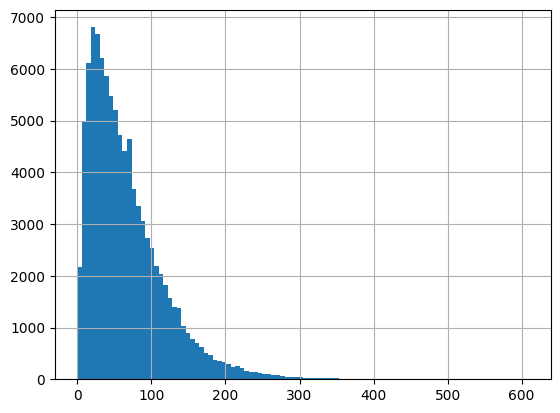

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

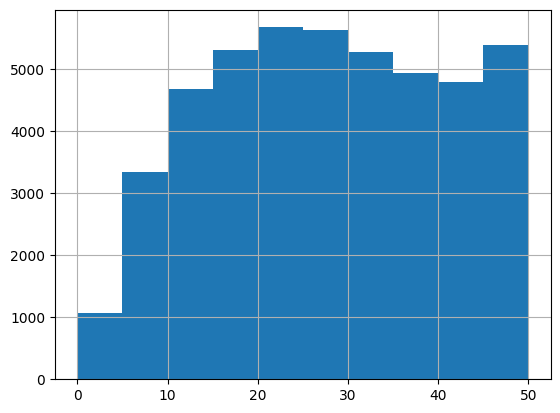

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 14402
Percentage of cells with less than 20 transcripts: 14.76%
-----
Number of cells with less than 15 transcripts: 9088
Percentage of cells with less than 15 transcripts: 9.32%
-----
Number of cells with less than 10 transcripts: 4406
Percentage of cells with less than 10 transcripts: 4.52%
-----
Number total of cells: 97560


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

92259


In [14]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [17]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


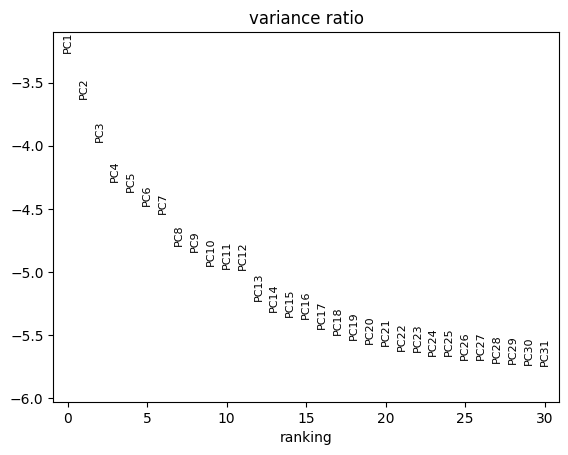

In [18]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [19]:
adata_cells

AnnData object with n_obs × n_vars = 92259 × 377
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [20]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [21]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_4330/1436083260.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


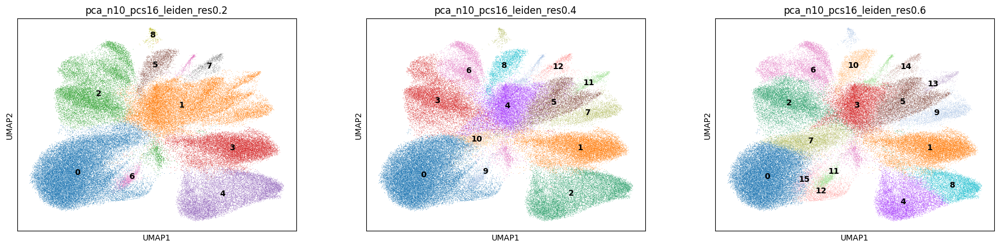

In [22]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16',
           color=['pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [23]:
# Number of clusters
adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].unique()

['0', '5', '4', '7', '6', ..., '9', '1', '10', '12', '8']
Length: 13
Categories (13, object): ['0', '1', '2', '3', ..., '9', '10', '11', '12']

In [24]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['9']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['10']), 'refine_res'] = '10'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['11']), 'refine_res'] = '11'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['12']), 'refine_res'] = '12'

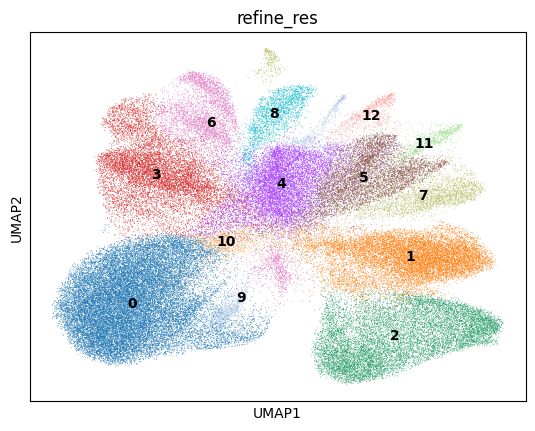

In [25]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [26]:
clustering_label = 'refine_res'

In [27]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

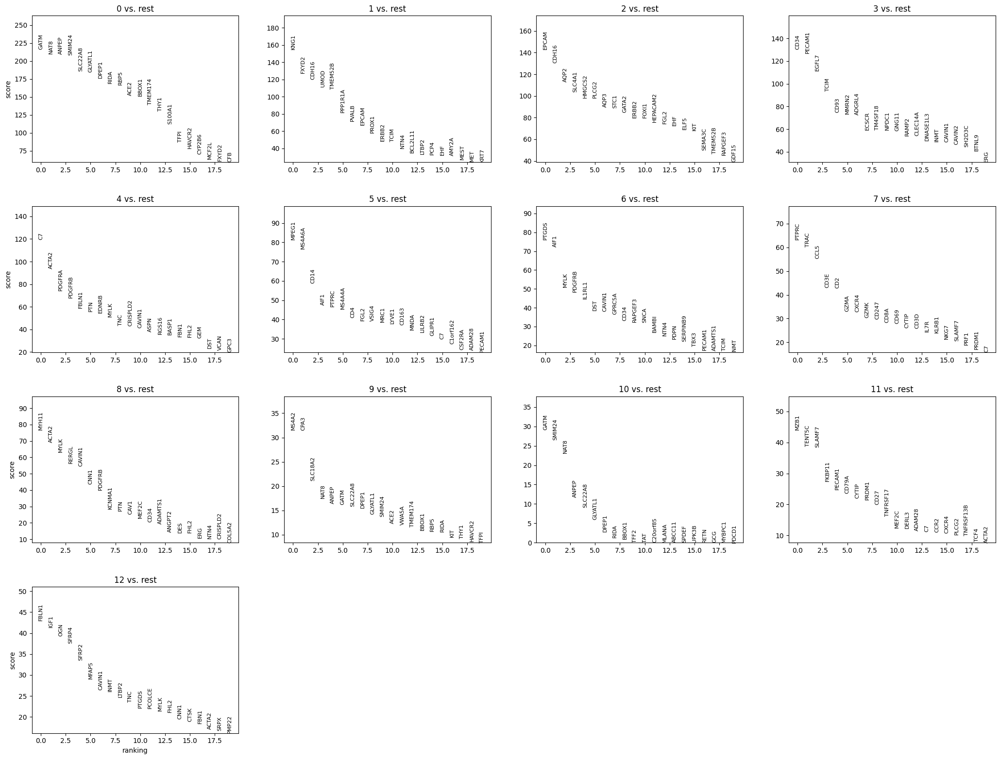

In [28]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [29]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [30]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [31]:
cluster_id = '0'

In [32]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Renal_proximal_tubule_epithelial_cell,normal_cell,75.4
1,NA,NA,NA,17.1
2,Epithelial,Podocyte_and_other_renal_epithelial_cells,normal_cell,6.6
3,Myofibroblast/Pericyte,Myofibroblast/Pericyte,normal_cell,0.3
4,Epithelial,Renal_Loop_of_Henle_or_distal_tubules_epitheli...,normal_cell,0.2


In [33]:
top_ranked_genes[cluster_id]

0       GATM
1       NAT8
2      ANPEP
3     SMIM24
4    SLC22A8
5    GLYATL1
6      DPEP1
Name: 0, dtype: object

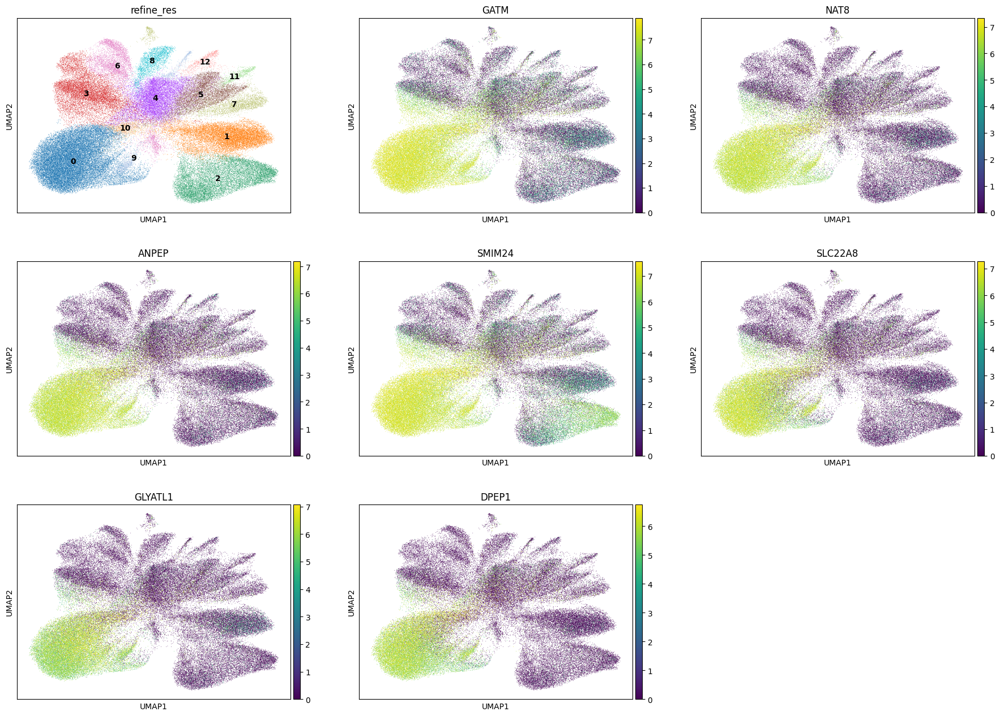

In [34]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [35]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 26919
Percentage of cells in cluster 0: 29.2


In [36]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Renal_proximal_tubule_epithelial_cell'

### 5.2. Cluster 1

In [37]:
cluster_id = '1'

In [38]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Renal_Loop_of_Henle_or_distal_tubules_epitheli...,normal_cell,80.3
1,NA,NA,NA,15.0
2,Epithelial,Epithelial_intercalated_cells_of_the_collectin...,normal_cell,1.3
3,Epithelial,Podocyte_and_other_renal_epithelial_cells,normal_cell,1.0
4,Epithelial,Collecting_duct_epithelial_cell,normal_cell,0.9


In [39]:
top_ranked_genes[cluster_id]

0       KNG1
1      FXYD2
2      CDH16
3       UMOD
4    TMEM52B
5    PPP1R1A
6      PVALB
Name: 1, dtype: object

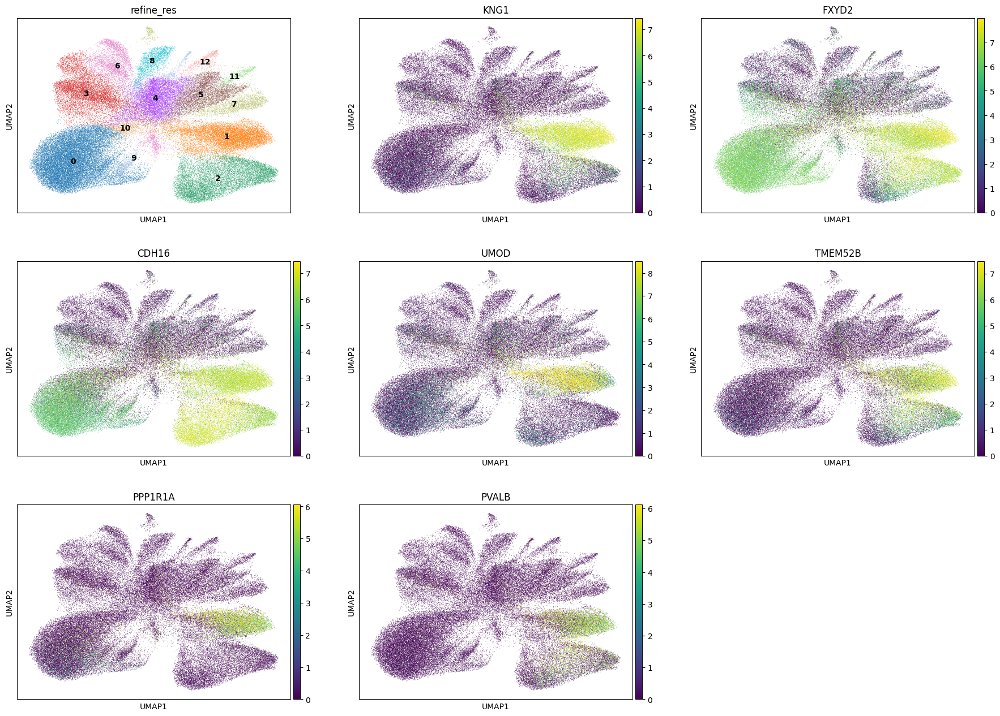

In [40]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [41]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 12297
Percentage of cells in cluster 1: 13.3


In [42]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Loop_of_Henle_epithelial_cell'

### 5.3. Cluster 2

In [43]:
cluster_id = '2'

In [44]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Collecting_duct_epithelial_cell,normal_cell,52.5
1,Epithelial,Epithelial_intercalated_cells_of_the_collectin...,normal_cell,34.8
2,NA,NA,NA,8.4
3,Epithelial,Renal_Loop_of_Henle_or_distal_tubules_epitheli...,normal_cell,2.8
4,Myofibroblast/Pericyte,Myofibroblast/Pericyte,normal_cell,0.5


In [45]:
top_ranked_genes[cluster_id]

0     EPCAM
1     CDH16
2      AQP2
3    SLC4A1
4    HMGCS2
5     PLCG2
6      AQP3
Name: 2, dtype: object

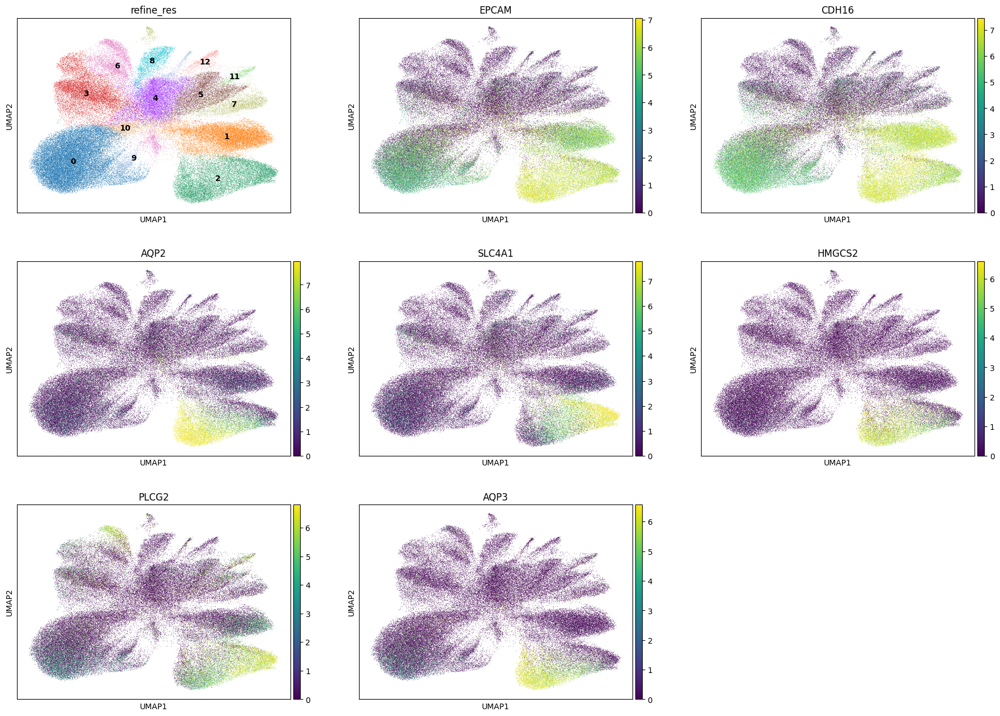

In [46]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [47]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 11630
Percentage of cells in cluster 2: 12.6


In [48]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Collecting_duct_epithelial_cell'

### 5.4. Cluster 3

In [49]:
cluster_id = '3'

In [50]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Endothelial,normal_cell,76.7
1,NA,NA,NA,19.5
2,Myofibroblast/Pericyte,Myofibroblast/Pericyte,normal_cell,2.0
3,Epithelial,Renal_proximal_tubule_epithelial_cell,normal_cell,0.7
4,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.4


In [51]:
top_ranked_genes[cluster_id]

0      CD34
1    PECAM1
2     EGFL7
3      TCIM
4      CD93
5     MMRN2
6    ADGRL4
Name: 3, dtype: object

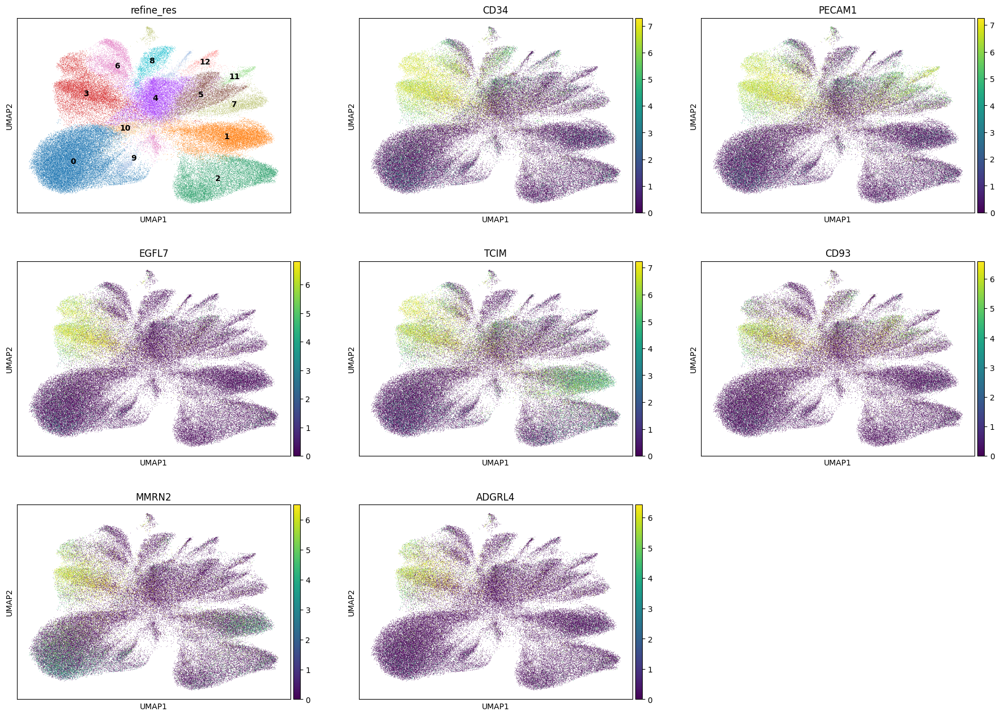

In [52]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [53]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 10614
Percentage of cells in cluster 3: 11.5


In [54]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.5. Cluster 4

In [55]:
cluster_id = '4'

In [56]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Myofibroblast/Pericyte,Myofibroblast/Pericyte,normal_cell,60.4
1,NA,NA,NA,32.1
2,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,2.5
3,Endothelial,Endothelial,normal_cell,1.4
4,Epithelial,Renal_proximal_tubule_epithelial_cell,normal_cell,0.9


In [57]:
top_ranked_genes[cluster_id]

0        C7
1     ACTA2
2    PDGFRA
3    PDGFRB
4     FBLN1
5       PTN
6     EDNRB
Name: 4, dtype: object

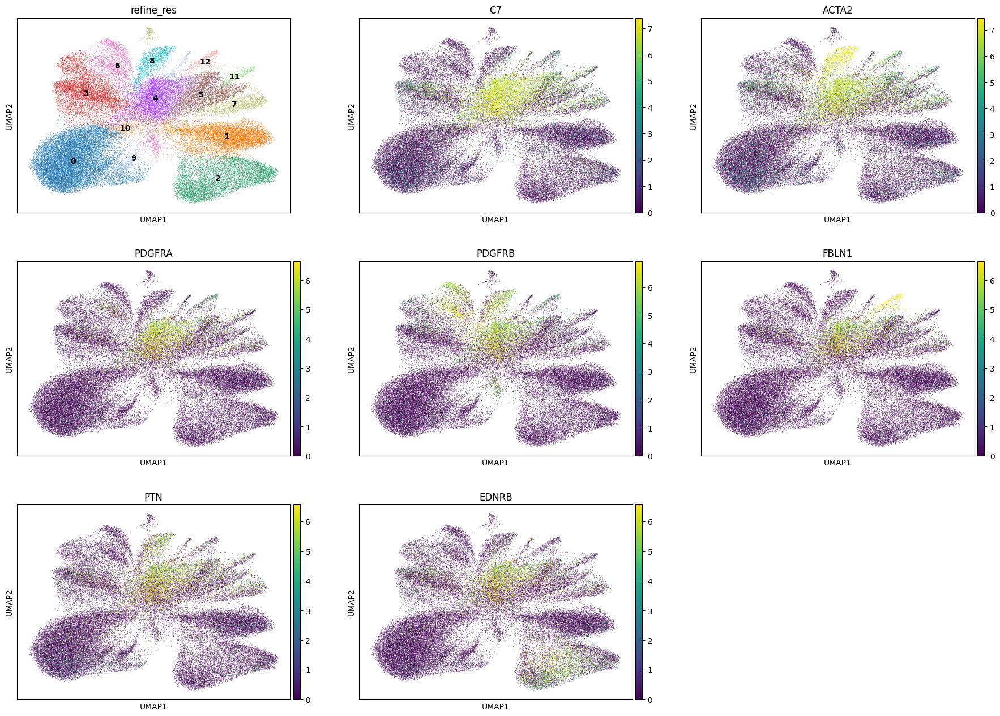

In [58]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [59]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 10008
Percentage of cells in cluster 4: 10.8


In [60]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Pericyte'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Pericyte'

### 5.6. Cluster 5

In [61]:
cluster_id = '5'

In [62]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,57.1
1,NA,NA,NA,33.8
2,Myofibroblast/Pericyte,Myofibroblast/Pericyte,normal_cell,5.0
3,T,T,normal_cell,1.3
4,Epithelial,Renal_proximal_tubule_epithelial_cell,normal_cell,0.9


In [63]:
top_ranked_genes[cluster_id]

0     MPEG1
1    MS4A6A
2      CD14
3      AIF1
4     PTPRC
5    MS4A4A
6       CD4
Name: 5, dtype: object

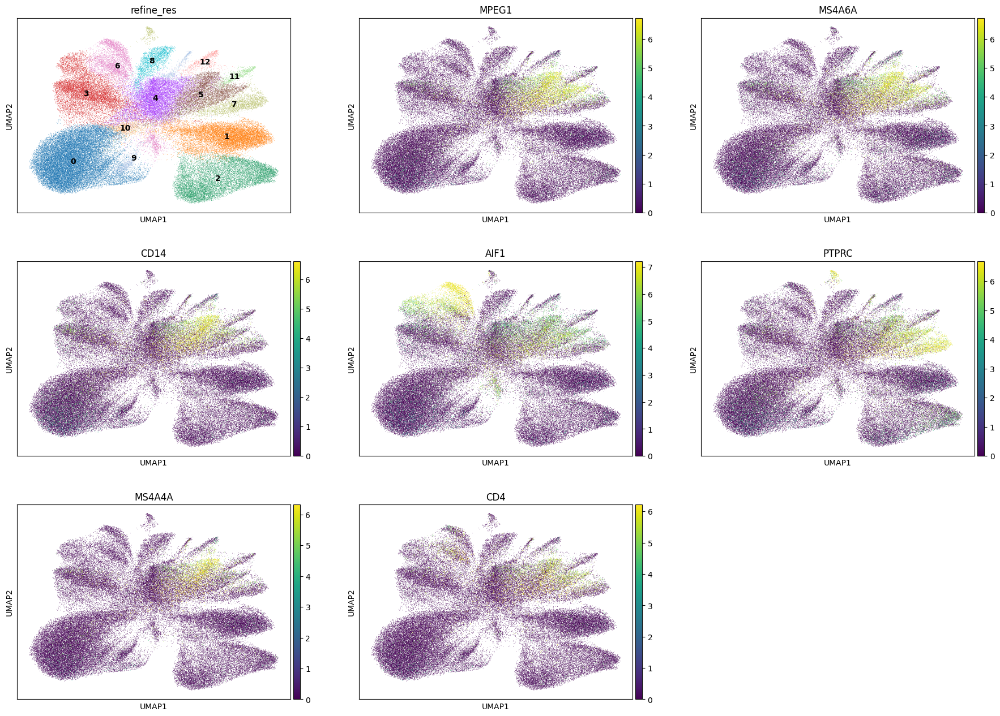

In [64]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [65]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 6478
Percentage of cells in cluster 5: 7.0


In [66]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.7. Cluster 6

In [67]:
cluster_id = '6'

In [68]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Podocyte_and_other_renal_epithelial_cells,normal_cell,36.2
1,NA,NA,NA,32.4
2,Myofibroblast/Pericyte,Myofibroblast/Pericyte,normal_cell,20.4
3,Endothelial,Endothelial,normal_cell,8.7
4,Epithelial,Renal_Loop_of_Henle_or_distal_tubules_epitheli...,normal_cell,0.8


In [69]:
top_ranked_genes[cluster_id]

0     PTGDS
1      AIF1
2      MYLK
3    PDGFRB
4    IL1RL1
5       DST
6    CAVIN1
Name: 6, dtype: object

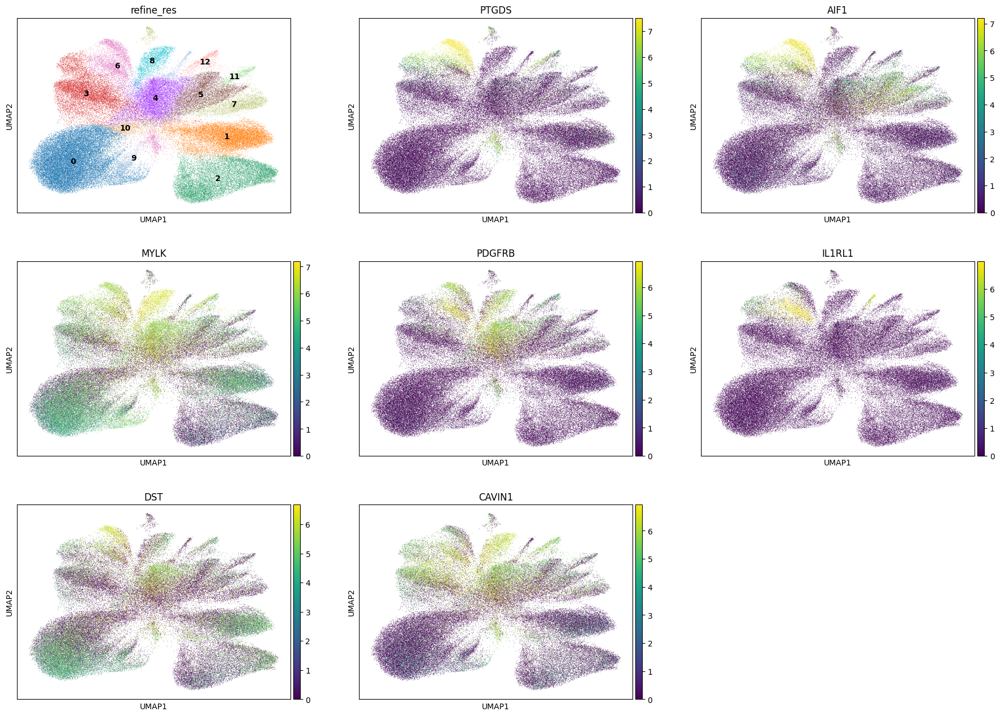

In [70]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [71]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 4599
Percentage of cells in cluster 6: 5.0


In [72]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Myofibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Myofibroblast'

### 5.8. Cluster 7

In [73]:
cluster_id = '7'

In [74]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,72.5
1,NA,NA,NA,18.5
2,Myofibroblast/Pericyte,Myofibroblast/Pericyte,normal_cell,4.4
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,2.5
4,Endothelial,Endothelial,normal_cell,0.6


In [75]:
top_ranked_genes[cluster_id]

0    PTPRC
1     TRAC
2     CCL5
3     CD3E
4      CD2
5     GZMA
6    CXCR4
Name: 7, dtype: object

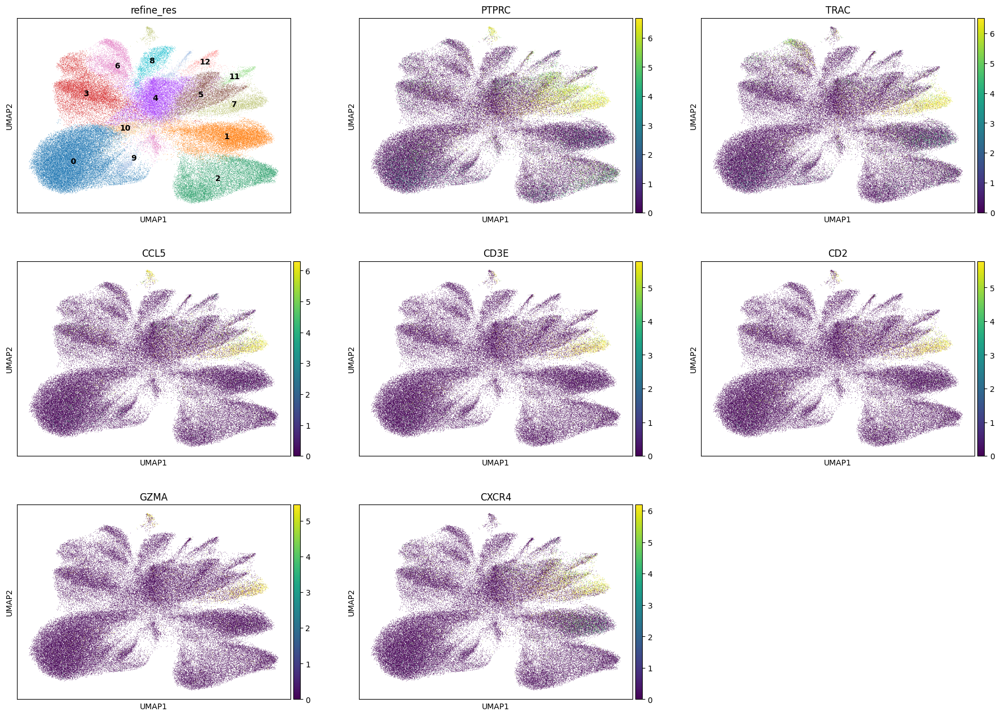

In [76]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [77]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 2925
Percentage of cells in cluster 7: 3.2


In [78]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.9. Cluster 8

In [79]:
cluster_id = '8'

In [80]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Smooth_muscle,Smooth_muscle,normal_cell,58.4
1,NA,NA,NA,30.1
2,Myofibroblast/Pericyte,Myofibroblast/Pericyte,normal_cell,10.0
3,Endothelial,Endothelial,normal_cell,0.7
4,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.3


In [81]:
top_ranked_genes[cluster_id]

0     MYH11
1     ACTA2
2      MYLK
3     RERGL
4    CAVIN1
5      CNN1
6    PDGFRB
Name: 8, dtype: object

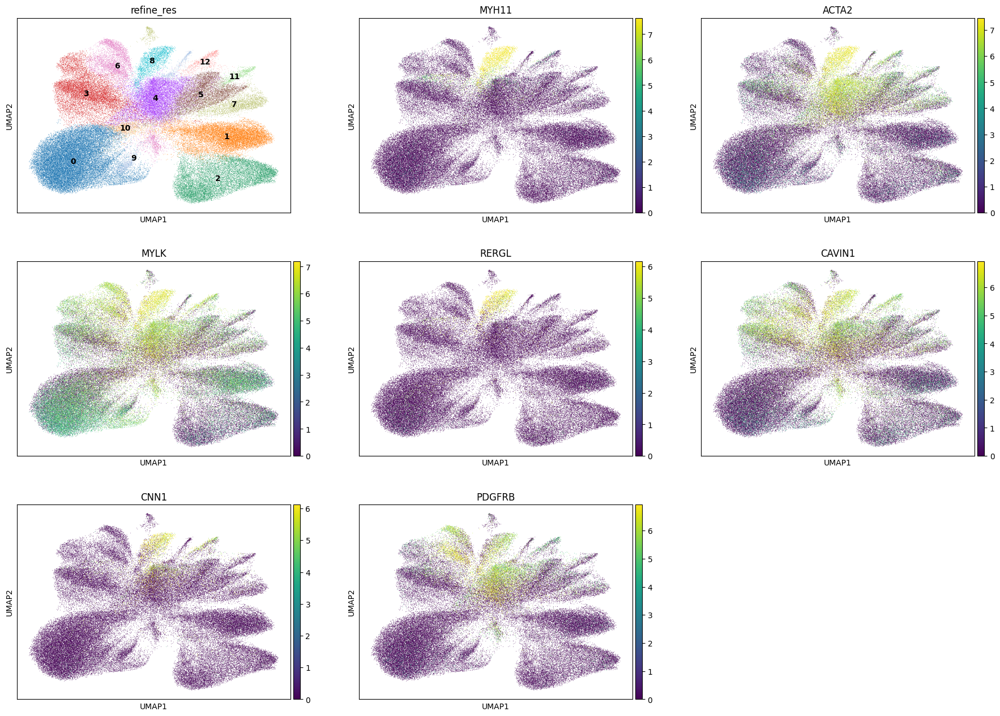

In [82]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [83]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 2282
Percentage of cells in cluster 8: 2.5


In [84]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Smooth_muscle'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Smooth_muscle'

### 5.10. Cluster 9

In [85]:
cluster_id = '9'

In [86]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Renal_proximal_tubule_epithelial_cell,normal_cell,50.3
1,Myofibroblast/Pericyte,Myofibroblast/Pericyte,normal_cell,16.0
2,NA,NA,NA,14.5
3,Mast,Mast,normal_cell,12.2
4,Endothelial,Endothelial,normal_cell,2.6


In [87]:
top_ranked_genes[cluster_id]

0      MS4A2
1       CPA3
2    SLC18A2
3       NAT8
4      ANPEP
5       GATM
6    SLC22A8
Name: 9, dtype: object

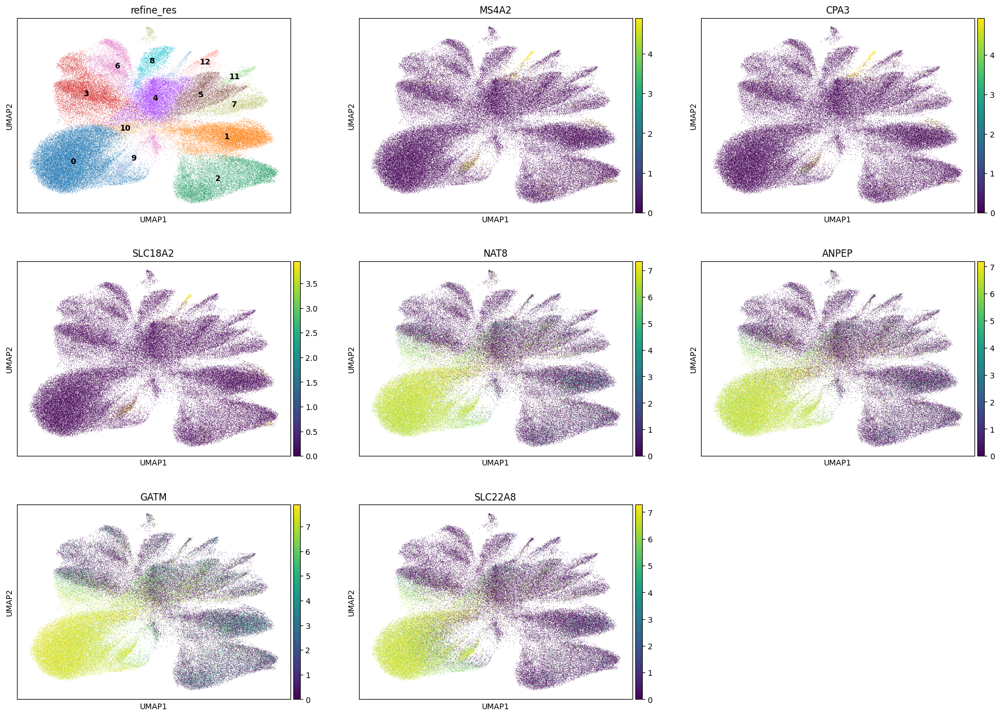

In [88]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [89]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 1645
Percentage of cells in cluster 9: 1.8


In [90]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Renal_epithelial_cell'

### 5.11. Cluster 10

In [91]:
cluster_id = '10'

In [92]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,92.1
1,Epithelial,Renal_proximal_tubule_epithelial_cell,normal_cell,6.5
2,Myofibroblast/Pericyte,Myofibroblast/Pericyte,normal_cell,0.6
3,Epithelial,Renal_Loop_of_Henle_or_distal_tubules_epitheli...,normal_cell,0.3
4,Endothelial,Endothelial,normal_cell,0.2


In [93]:
top_ranked_genes[cluster_id]

0       GATM
1     SMIM24
2       NAT8
3      ANPEP
4    SLC22A8
5    GLYATL1
6      DPEP1
Name: 10, dtype: object

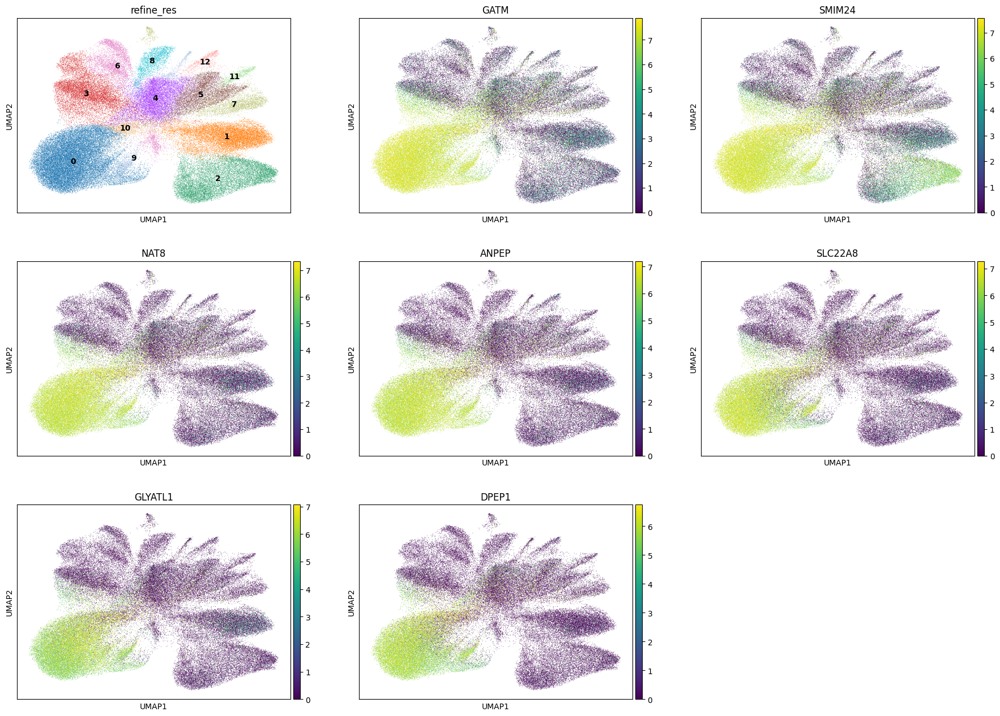

In [94]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [95]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 1086
Percentage of cells in cluster 10: 1.2


In [96]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Renal_proximal_tubule_epithelial_cell	'

### 5.12. Cluster 11

In [97]:
cluster_id = '11'

In [98]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Plasma,Plasma,normal_cell,54.7
1,NA,NA,NA,28.6
2,Myofibroblast/Pericyte,Myofibroblast/Pericyte,normal_cell,5.4
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,3.9
4,T,T,normal_cell,3.2


In [99]:
top_ranked_genes[cluster_id]

0      MZB1
1    TENT5C
2    SLAMF7
3    FKBP11
4    PECAM1
5     CD79A
6     CYTIP
Name: 11, dtype: object

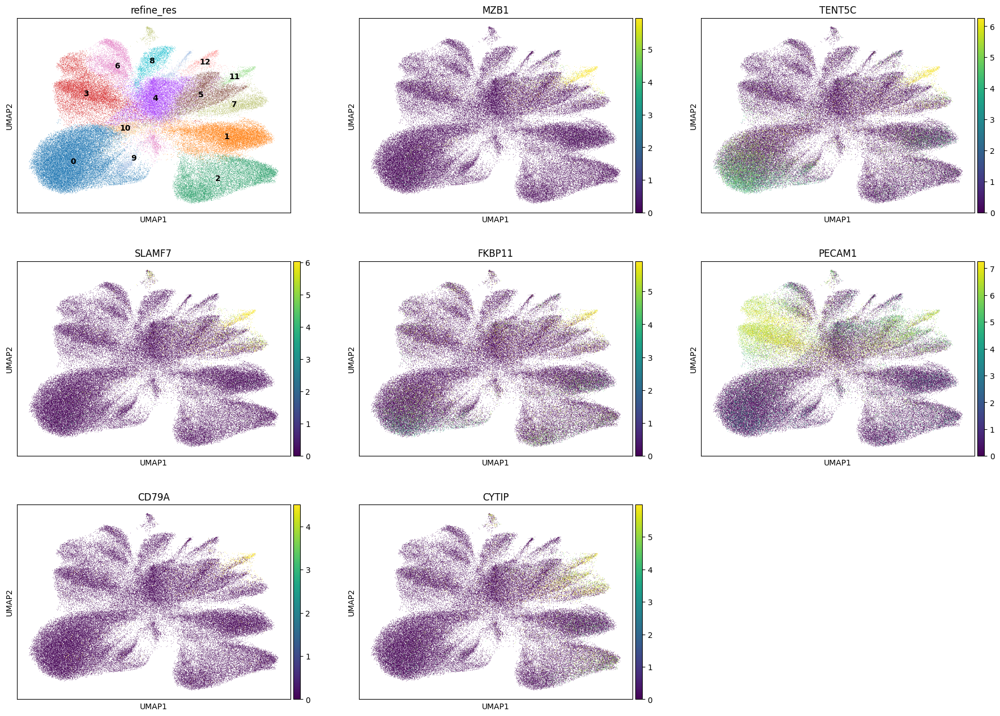

In [100]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [101]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 943
Percentage of cells in cluster 11: 1.0


In [102]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Plasma'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Plasma'

### 5.13. Cluster 12

In [103]:
cluster_id = '12'

In [104]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast/Myofibroblast,Fibroblast/Myofibroblast,normal_cell,47.8
1,NA,NA,NA,26.2
2,Myofibroblast/Pericyte,Myofibroblast/Pericyte,normal_cell,11.8
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,8.0
4,Smooth_muscle,Smooth_muscle,normal_cell,1.7


In [105]:
top_ranked_genes[cluster_id]

0     FBLN1
1      IGF1
2       OGN
3     SFRP4
4     SFRP2
5     MFAP5
6    CAVIN1
Name: 12, dtype: object

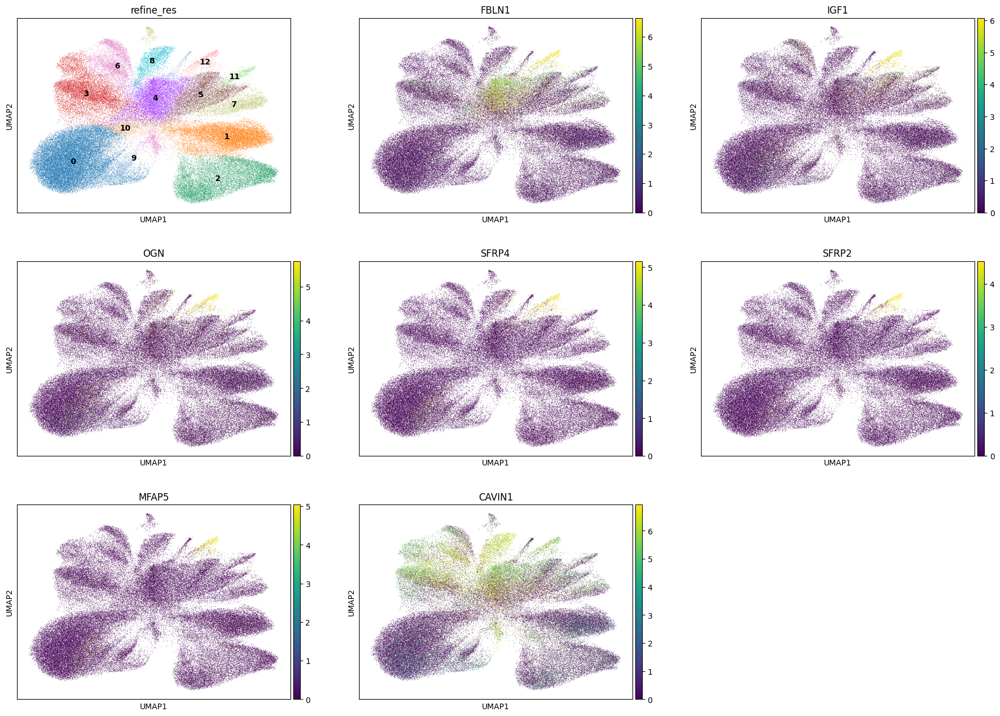

In [106]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [107]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 12: 833
Percentage of cells in cluster 12: 0.9


In [108]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

## 6. Cancer cells

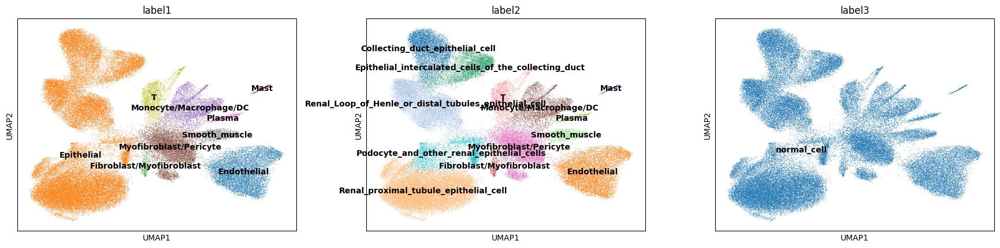

In [111]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


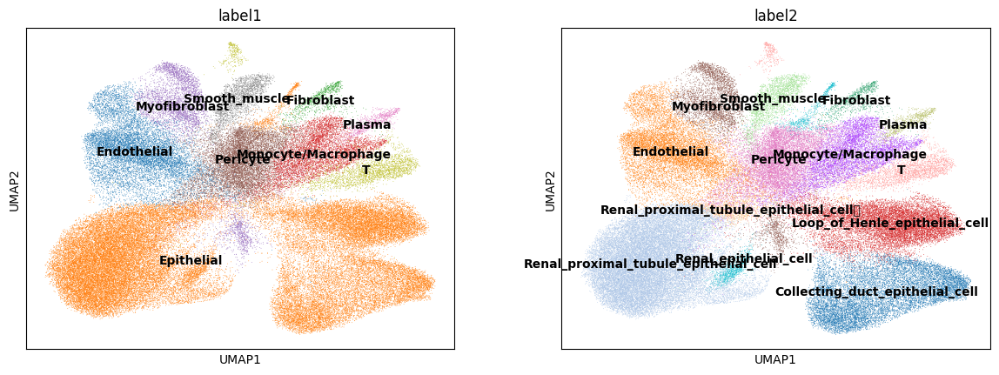

In [112]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [113]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 9 (	) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


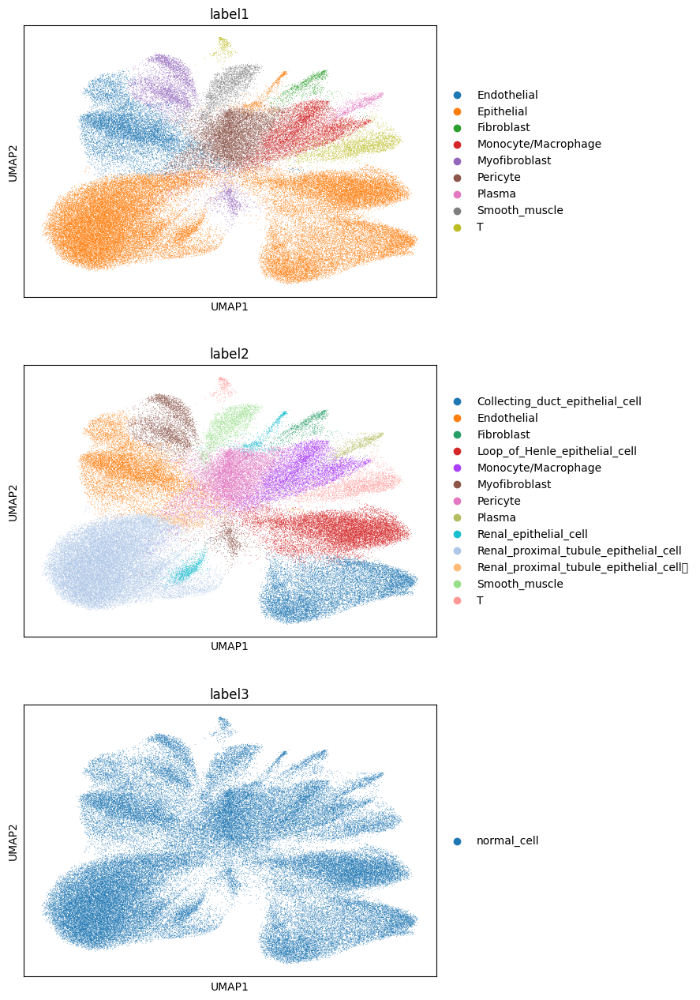

In [114]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [115]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
0,aaaaaaaa-1,213,0,0,0,0,213,272.337354,19.462344,cell_labels,0,0,0,0,Epithelial,Renal_proximal_tubule_epithelial_cell,normal_cell
1,aaaaaaab-1,152,0,0,0,0,152,117.677192,19.642969,cell_labels,0,0,0,0,Epithelial,Renal_proximal_tubule_epithelial_cell,normal_cell
2,aaaaaaac-1,30,0,0,0,0,30,75.681878,19.552657,cell_labels,1,5,5,5,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
3,aaaaaaad-1,133,0,0,0,0,133,198.642351,43.666095,cell_labels,0,0,0,0,Epithelial,Renal_proximal_tubule_epithelial_cell,normal_cell
4,aaaaaaae-1,87,0,0,0,0,87,132.804536,27.545313,cell_labels,1,4,3,4,Pericyte,Pericyte,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97553,aaabhnbb-1,40,0,0,0,0,40,267.415322,15.172501,cell_labels,2,6,6,6,Myofibroblast,Myofibroblast,normal_cell
97554,aaabhnbc-1,141,0,0,0,0,141,386.447202,34.092970,cell_labels,4,2,1,2,Epithelial,Collecting_duct_epithelial_cell,normal_cell
97555,aaabhnbd-1,55,0,0,0,0,55,159.943443,18.875313,cell_labels,1,5,5,5,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
97556,aaabhnbe-1,22,0,0,1,0,23,419.320953,13.862969,cell_labels,1,5,5,5,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell


In [116]:
adata_cells.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")